In [ ]:

from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


#Import Liabries

In [ ]:
import numpy as np 
import pandas as pd 

import matplotlib.pyplot as plt
import seaborn as sns


from sklearn.model_selection import train_test_split
from imblearn.over_sampling import RandomOverSampler

from PIL import Image

import tensorflow as tf
from keras.models import Sequential
from keras.layers import Input, Conv2D, MaxPooling2D
from keras.layers import Activation, Dropout, Flatten, Dense, BatchNormalization
from keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau
from keras.preprocessing.image import ImageDataGenerator

import os, cv2

#Load Data

In [ ]:
df=pd.read_csv("/content/hmnist_28_28_RGB.csv")
other = pd.read_csv("/content/ISIC_2020_Training_GroundTruth.csv")

In [ ]:
df

,pixel0000,pixel0001,pixel0002,pixel0003,pixel0004,pixel0005,pixel0006,pixel0007,pixel0008,pixel0009,pixel0010,pixel0011,pixel0012,pixel0013,pixel0014,pixel0015,pixel0016,pixel0017,pixel0018,pixel0019,pixel0020,pixel0021,pixel0022,pixel0023,pixel0024,pixel0025,pixel0026,pixel0027,pixel0028,pixel0029,pixel0030,pixel0031,pixel0032,pixel0033,pixel0034,pixel0035,pixel0036,pixel0037,pixel0038,pixel0039,...,pixel2313,pixel2314,pixel2315,pixel2316,pixel2317,pixel2318,pixel2319,pixel2320,pixel2321,pixel2322,pixel2323,pixel2324,pixel2325,pixel2326,pixel2327,pixel2328,pixel2329,pixel2330,pixel2331,pixel2332,pixel2333,pixel2334,pixel2335,pixel2336,pixel2337,pixel2338,pixel2339,pixel2340,pixel2341,pixel2342,pixel2343,pixel2344,pixel2345,pixel2346,pixel2347,pixel2348,pixel2349,pixel2350,pixel2351,label
0,192,153,193,195,155,192,197,154,185,202,162,192,208,165,201,209,165,205,208,165,194,212,169,198,216,181,204,216,178,204,215,172,205,217,173,209,217,166,202,214,...,216,181,212,215,176,208,213,168,191,209,159,184,212,168,194,212,172,198,208,173,193,203,168,183,190,142,152,177,123,134,173,124,138,183,147,166,185,154,177,2
1,25,14,30,68,48,75,123,93,126,158,128,158,172,136,162,175,134,157,177,126,158,186,138,163,197,153,187,198,153,186,203,168,206,205,169,204,207,164,199,205,...,209,176,203,207,171,191,208,172,197,205,169,188,198,159,172,200,159,192,191,140,182,177,128,141,147,101,97,113,79,82,60,39,55,25,14,28,25,14,27,2
2,192,138,153,200,145,163,201,142,160,206,149,165,207,149,159,209,156,164,202,136,130,200,133,129,208,146,157,212,159,167,214,157,168,211,143,150,215,148,169,213,...,221,168,175,222,170,188,221,167,184,203,144,155,201,146,155,210,163,177,190,142,152,192,152,172,194,153,176,178,134,149,167,129,143,159,124,142,136,104,117,2
3,38,19,30,95,59,72,143,103,119,171,125,134,177,118,123,190,137,146,192,127,143,200,141,162,207,156,170,202,144,151,202,138,155,212,159,177,211,155,172,211,...,181,137,145,189,147,166,192,157,185,169,129,144,148,114,122,157,125,137,157,127,147,154,128,147,130,102,114,87,63,73,44,26,36,25,12,17,25,12,15,2
4,158,113,139,194,144,174,215,162,191,225,179,214,232,189,222,235,193,219,234,191,206,238,200,219,244,213,240,243,213,239,242,210,238,244,216,241,247,224,244,246,...,238,195,209,237,191,200,238,194,201,239,197,216,238,195,219,232,179,201,217,150,173,224,171,207,227,177,206,222,178,201,209,166,185,172,135,149,109,78,92,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10010,183,165,181,182,165,180,184,166,182,188,168,182,181,157,162,205,179,188,221,199,214,224,202,215,226,201,205,223,198,206,230,207,219,228,201,211,229,203,210,223,...,225,197,195,222,193,193,228,199,202,231,202,204,227,203,206,230,211,219,231,217,223,222,204,207,202,179,180,205,180,181,208,185,187,208,186,186,206,187,189,0
10011,2,3,1,38,33,32,121,104,103,132,111,107,130,108,104,136,112,111,148,125,125,155,132,134,157,132,132,164,138,137,187,161,161,198,172,173,202,175,175,209,...,207,179,179,195,164,162,197,168,169,203,176,180,192,165,165,188,162,162,184,162,164,185,162,163,161,137,135,155,132,129,96,79,76,24,23,21,3,4,1,0
10012,132,118,118,167,149,149,175,156,160,184,164,167,195,173,175,210,191,199,212,195,201,210,189,193,218,194,203,217,191,195,217,195,199,224,201,203,236,211,215,250,...,200,169,165,217,183,179,241,211,210,242,216,215,239,214,213,234,208,208,224,198,196,206,180,177,226,202,201,214,192,190,204,181,178,181,159,153,172,151,145,0
10013,160,124,146,164,131,152,167,127,146,169,124,142,173,134,149,177,139,156,181,141,159,183,137,154,185,139,160,185,145,165,186,148,162,189,157,170,190,155,169,191,...,189,141,159,192,167,179,193,173,183,192,171,181,190,164,171,190,162,171,190,168,179,194,177,187,192,170,180,186,163,165,185,162,167,184,157,166,185,162,172,0

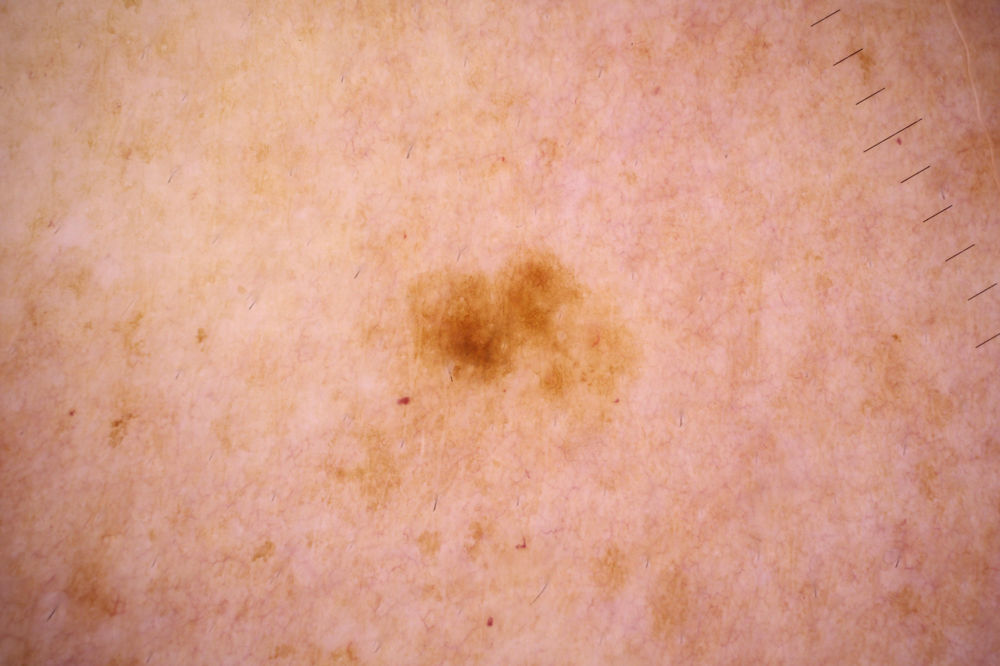

In [ ]:
Image.open('/content/gdrive/MyDrive/data/ISIC_2020_Test_JPEG/ISIC_2020_Test_Input/ISIC_0154289.jpg')  #View Image

In [ ]:
#Label the images
label = df["label"]
df = df.drop(columns=["label"]) 

#Visualization

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


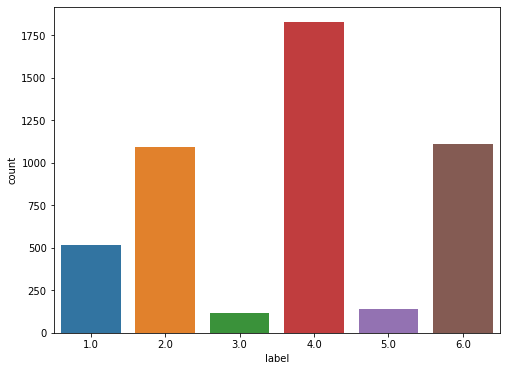

In [ ]:
plt.figure(figsize = (8,6))
sns.countplot(label)

Text(0.5, 1.0, 'Gender of Patient')

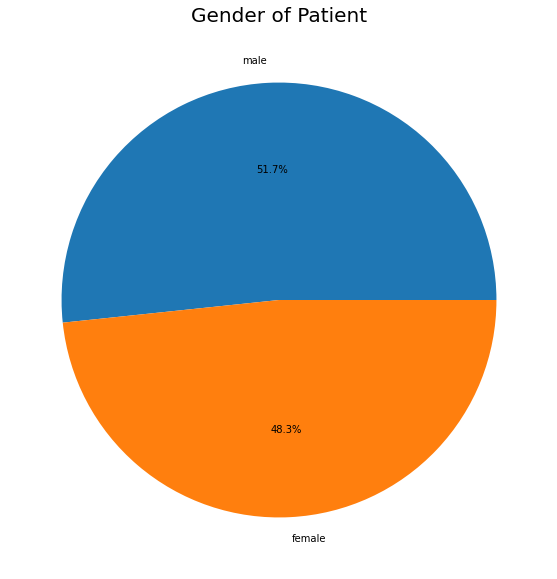

In [ ]:
bar, ax = plt.subplots(figsize = (10,10))
plt.pie(other['sex'].value_counts(), 
        labels = other['sex'].value_counts().index, 
        autopct="%.1f%%")
plt.title('Gender of Patient', size=20)

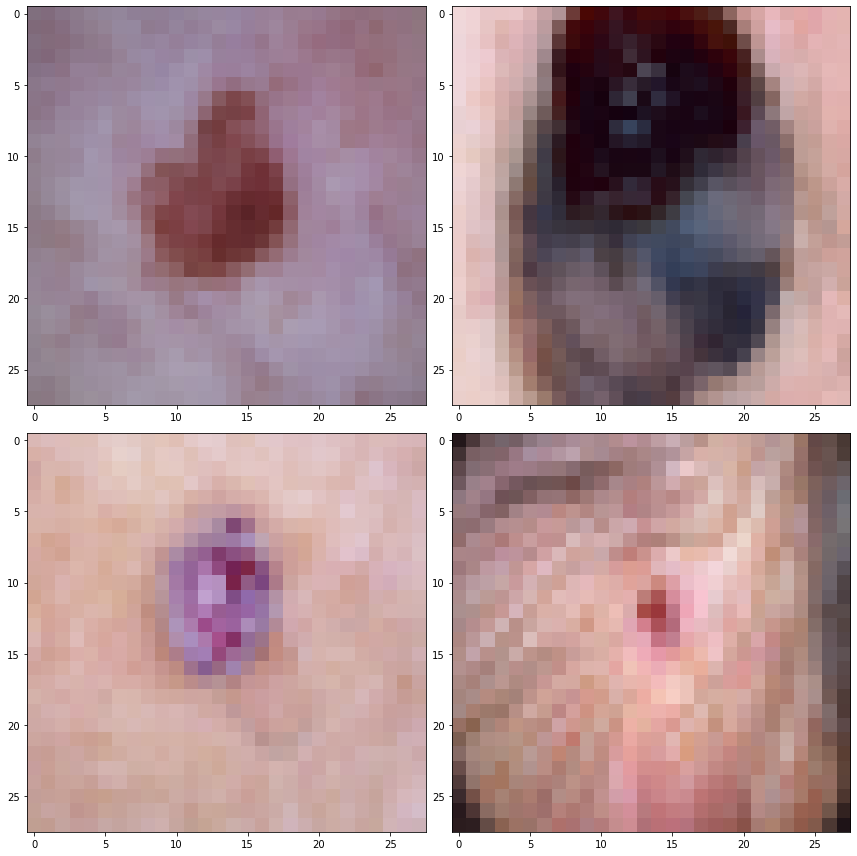

In [ ]:
fig, axes = plt.subplots(2, 2)
fig.set_size_inches(12, 12)
k = 0 
for i in range(2):
    for j in range(2):
        axes[i, j].imshow(X_train[k])
        k += 1
plt.tight_layout()

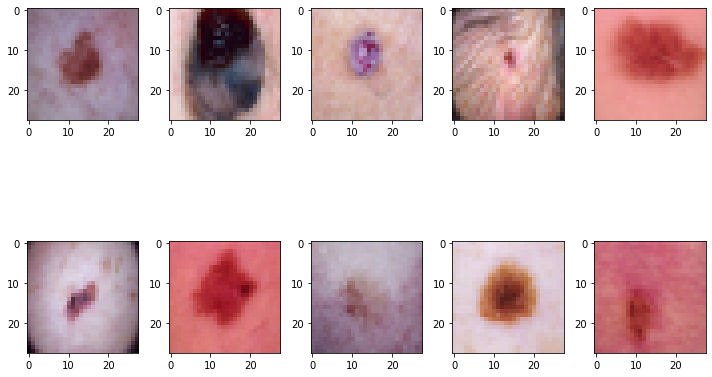

In [ ]:
f , ax = plt.subplots(2,5)
f.set_size_inches(10, 10)
k = 0 
for i in range(2):
    for j in range(5):
        ax[i,j].imshow(X_train[k].reshape(28,28,3))
        k = k + 1
    plt.tight_layout()

#Standarization and Split the data

In [ ]:
X_train , X_test , y_train , y_test = train_test_split(df , label , test_size = 0.2)

#Overcome Imbalance class

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function safe_indexing is deprecated; safe_indexing is deprecated in version 0.22 and will be removed in version 0.24.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


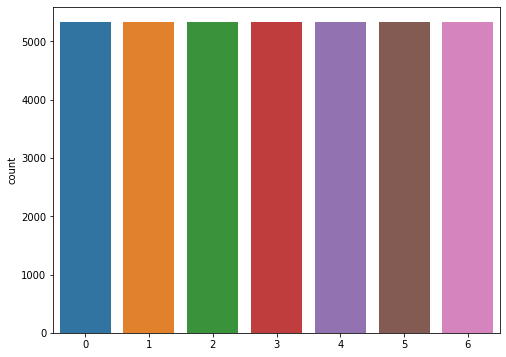

In [ ]:
sampler = RandomOverSampler()
X_train, y_train = sampler.fit_resample(X_train, y_train)

plt.figure(figsize = (8,6))
sns.countplot(y_train)

In [ ]:
#Reshape the splitted data
X_train = np.array(X_train).reshape(-1,28,28,3)
X_test = np.array(X_test).reshape(-1,28,28,3)

In [ ]:
y_train = tf.keras.utils.to_categorical(y_train)
y_test = tf.keras.utils.to_categorical(y_test)

#Model - 1 - Relu activation and loss function: categorical_crossentropy and Adam optimizer

In [ ]:
from keras import backend as K

def recall_m(y_true, y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    possible_positives = K.sum(K.round(K.clip(y_true, 0, 1)))
    recall = true_positives / (possible_positives + K.epsilon())
    return recall

def precision_m(y_true, y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    predicted_positives = K.sum(K.round(K.clip(y_pred, 0, 1)))
    precision = true_positives / (predicted_positives + K.epsilon())
    return precision

def f1_m(y_true, y_pred):
    precision = precision_m(y_true, y_pred)
    recall = recall_m(y_true, y_pred)
    return 2*((precision*recall)/(precision+recall+K.epsilon()))

In [ ]:
# add Conv2D layer & another set of Convolutional & Max Pooling layers

model = Sequential([
            Input(shape = [28,28,3]),
            Conv2D(64 , (3,3) , activation='relu',padding='same'),
            MaxPooling2D(),
            BatchNormalization(),
            Conv2D(128 , (3,3) , activation='relu',padding='same'),
            Conv2D(128 , (3,3) , activation='relu',padding='same'),
            MaxPooling2D(),
            BatchNormalization(), 
            Conv2D(256 , (3,3) , activation='relu',padding='same'),
            Conv2D(256 , (3,3) , activation='relu',padding='same'),
            MaxPooling2D(),
            BatchNormalization(),
            Conv2D(512 , (3,3) , activation='relu',padding='same'),
            Conv2D(512 , (3,3) , activation='relu',padding='same'),
            MaxPooling2D(),
#             BatchNormalization(),
#             Conv2D(512 , (3,3) , activation='relu',padding='same'),
#             Conv2D(512 , (3,3) , activation='relu',padding='same'),
#             MaxPooling2D(),
            Flatten(),
            Dropout(.5),
            Dense(256, activation = 'relu'),
            BatchNormalization(),
            Dropout(.5),
            Dense(128, activation = 'relu'),
            BatchNormalization(),
            Dropout(.5),
            Dense(64, activation = 'relu'),
            BatchNormalization(),
            Dense(32, activation = 'relu'),
            BatchNormalization(),
            Dense(7, activation = 'softmax'),
])

model.compile(loss='categorical_crossentropy',optimizer="adam",metrics=[f1_m, 'accuracy'])

In [ ]:
#make model folder model
model._name = 'skincancer_CNN'
model_save_path = "."
if not os.path.exists(model_save_path):
    os.mkdir(model_save_path)

#Early stop to overcome overfitting problem

In [ ]:
early_stop = EarlyStopping(patience=10, verbose=1, monitor='val_f1_m', mode='max')
reduce_lr =  ReduceLROnPlateau(monitor='val_f1_m', factor=0.1, patience=7, min_delta=1e-4, mode='max')
checkpoint = ModelCheckpoint(os.path.join(model_save_path, model.name+".h5"), save_weights_only=True,
                             verbose=1, save_best_only=True, monitor='val_f1_m', mode='max')

In [ ]:
model.summary()

Model: "skincancer_CNN"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_7 (Conv2D)            (None, 28, 28, 64)        1792      
_________________________________________________________________
max_pooling2d_4 (MaxPooling2 (None, 14, 14, 64)        0         
_________________________________________________________________
batch_normalization_7 (Batch (None, 14, 14, 64)        256       
_________________________________________________________________
conv2d_8 (Conv2D)            (None, 14, 14, 128)       73856     
_________________________________________________________________
conv2d_9 (Conv2D)            (None, 14, 14, 128)       147584    
_________________________________________________________________
max_pooling2d_5 (MaxPooling2 (None, 7, 7, 128)         0         
_________________________________________________________________
batch_normalization_8 (Batch (None, 7, 7, 128)      

In [ ]:
history = model.fit(X_train,
                    y_train,
                    epochs=50,
                    batch_size=128,
                    steps_per_epoch=len(X_train)//128,
                    validation_data= (X_test, y_test),
                    callbacks=[early_stop, checkpoint, reduce_lr])

Epoch 1/50
291/291 [==============================] - 58s 32ms/step - loss: 1.8720 - f1_m: 0.1499 - accuracy: 0.2831 - val_loss: 1.0247 - val_f1_m: 0.6521 - val_accuracy: 0.6485

Epoch 00001: val_f1_m improved from -inf to 0.65208, saving model to ./skincancer_CNN.h5
Epoch 2/50
291/291 [==============================] - 9s 27ms/step - loss: 0.9463 - f1_m: 0.5614 - accuracy: 0.6354 - val_loss: 1.7532 - val_f1_m: 0.3188 - val_accuracy: 0.3210

Epoch 00002: val_f1_m did not improve from 0.65208
Epoch 3/50
291/291 [==============================] - 8s 27ms/step - loss: 0.5262 - f1_m: 0.8047 - accuracy: 0.8106 - val_loss: 1.5677 - val_f1_m: 0.4816 - val_accuracy: 0.4838

Epoch 00003: val_f1_m did not improve from 0.65208
Epoch 4/50
291/291 [==============================] - 8s 27ms/step - loss: 0.3663 - f1_m: 0.8728 - accuracy: 0.8734 - val_loss: 0.9402 - val_f1_m: 0.7276 - val_accuracy: 0.7279

Epoch 00004: val_f1_m improved from 0.65208 to 0.72755, saving model to ./skincancer_CNN.h5
Epoc

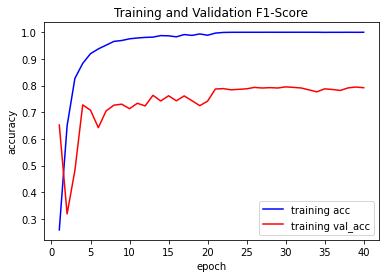

In [ ]:
f1 = history.history["f1_m"]
val_f1 = history.history["val_f1_m"]
epochs = range(1, len(val_f1) + 1)

plt.plot(epochs, f1, color="blue", label="training acc")
plt.plot(epochs, val_f1, color="red", label="training val_acc")
plt.legend()
plt.xlabel("epoch")
plt.ylabel("accuracy")
plt.title("Training and Validation F1-Score")
# plt.savefig(f"./balanced/models/{model._name}_f1_training_plot.jpg")
plt.show()

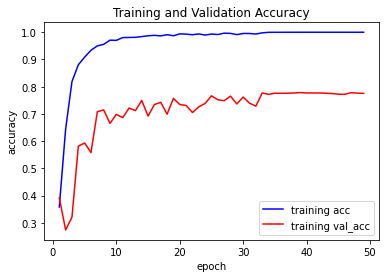

In [ ]:
acc = history.history["accuracy"]
val_acc = history.history["val_accuracy"]
epochs = range(1, len(val_acc) + 1)

plt.plot(epochs, acc, color="blue", label="training acc")
plt.plot(epochs, val_acc, color="red", label="training val_acc")
plt.legend()
plt.xlabel("epoch")
plt.ylabel("accuracy")
plt.title("Training and Validation Accuracy")
# plt.savefig(f"./balanced/models/{model._name}_f1_training_plot.jpg")
plt.show()

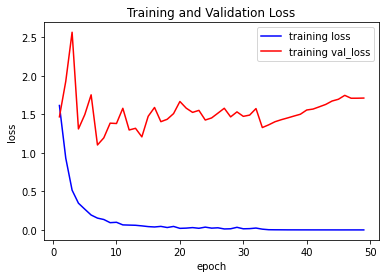

In [ ]:
loss = history.history["loss"]
val_loss = history.history["val_loss"]
epochs = range(1, len(val_acc) + 1)

plt.plot(epochs, loss, color="blue", label="training loss")
plt.plot(epochs, val_loss, color="red", label="training val_loss")

plt.legend()
plt.xlabel("epoch")
plt.ylabel("loss")
plt.title("Training and Validation Loss")

plt.show()

## Experiment 2 - TANH Model

In [ ]:
model2 = Sequential([
            Input(shape = [28,28,3]),
            Conv2D(64 , (3,3) , activation='tanh',padding='same'),
            MaxPooling2D(),
            BatchNormalization(),
            Conv2D(128 , (3,3) , activation='tanh',padding='same'),
            Conv2D(128 , (3,3) , activation='tanh',padding='same'),
            MaxPooling2D(),
            BatchNormalization(), 
            Conv2D(256 , (3,3) , activation='tanh',padding='same'),
            Conv2D(256 , (3,3) , activation='tanh',padding='same'),
            MaxPooling2D(),
            BatchNormalization(),
            Conv2D(512 , (3,3) , activation='tanh',padding='same'),
            Conv2D(512 , (3,3) , activation='tanh',padding='same'),
            MaxPooling2D(),
#             BatchNormalization(),
#             Conv2D(512 , (3,3) , activation='tanh',padding='same'),
#             Conv2D(512 , (3,3) , activation='tanh',padding='same'),
#             MaxPooling2D(),
            Flatten(),
            Dropout(.5),
            Dense(256, activation = 'tanh', ),
            BatchNormalization(),
            Dropout(.5),
            Dense(128, activation = 'tanh',),
            BatchNormalization(),
            Dropout(.5),
            Dense(64, activation = 'tanh',),
            BatchNormalization(),
            Dense(32, activation = 'tanh',),
            BatchNormalization(),
            Dense(7, activation = 'softmax'),
])

model2.compile(loss='binary_crossentropy',optimizer="adam",metrics=[f1_m, 'accuracy'])

In [ ]:
model2.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_14 (Conv2D)           (None, 28, 28, 64)        1792      
_________________________________________________________________
max_pooling2d_8 (MaxPooling2 (None, 14, 14, 64)        0         
_________________________________________________________________
batch_normalization_14 (Batc (None, 14, 14, 64)        256       
_________________________________________________________________
conv2d_15 (Conv2D)           (None, 14, 14, 128)       73856     
_________________________________________________________________
conv2d_16 (Conv2D)           (None, 14, 14, 128)       147584    
_________________________________________________________________
max_pooling2d_9 (MaxPooling2 (None, 7, 7, 128)         0         
_________________________________________________________________
batch_normalization_15 (Batc (None, 7, 7, 128)        

In [ ]:
history2 = model2.fit(X_train,
                    y_train,
                    epochs=50,
                    batch_size=128,
                    steps_per_epoch=len(X_train)//128,
                    validation_data= (X_test, y_test),
                    callbacks=[early_stop, checkpoint, reduce_lr])

Epoch 1/50
291/291 [==============================] - 14s 34ms/step - loss: 0.6233 - f1_m: 0.0531 - accuracy: 0.2443 - val_loss: 0.3986 - val_f1_m: 0.0124 - val_accuracy: 0.2421

Epoch 00001: val_f1_m did not improve from 0.79511
Epoch 2/50
291/291 [==============================] - 9s 30ms/step - loss: 0.3401 - f1_m: 0.2014 - accuracy: 0.3835 - val_loss: 0.2797 - val_f1_m: 0.6878 - val_accuracy: 0.6880

Epoch 00002: val_f1_m did not improve from 0.79511
Epoch 3/50
291/291 [==============================] - 9s 30ms/step - loss: 0.3130 - f1_m: 0.3228 - accuracy: 0.4297 - val_loss: 0.2920 - val_f1_m: 0.5367 - val_accuracy: 0.5657

Epoch 00003: val_f1_m did not improve from 0.79511
Epoch 4/50
291/291 [==============================] - 9s 30ms/step - loss: 0.2936 - f1_m: 0.4166 - accuracy: 0.4898 - val_loss: 0.3211 - val_f1_m: 0.2931 - val_accuracy: 0.2996

Epoch 00004: val_f1_m did not improve from 0.79511
Epoch 5/50
291/291 [==============================] - 9s 29ms/step - loss: 0.2746 -

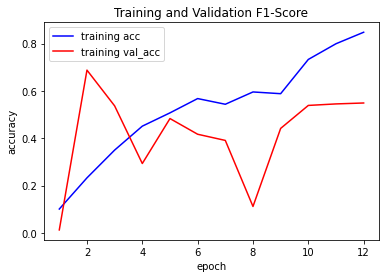

In [ ]:
f1 = history2.history["f1_m"]
val_f1 = history2.history["val_f1_m"]
epochs = range(1, len(val_f1) + 1)

plt.plot(epochs, f1, color="blue", label="training acc")
plt.plot(epochs, val_f1, color="red", label="training val_acc")
plt.legend()
plt.xlabel("epoch")
plt.ylabel("accuracy")
plt.title("Training and Validation F1-Score")
# plt.savefig(f"./balanced/models/{model2._name}_f1_training_plot.jpg")
plt.show()

#Expeiment - 3 - Relu activation and binary_crossentropy as a loss function. Output layer used sigmoid instead of softmax

In [ ]:
# add Conv2D layer & another set of Convolutional & Max Pooling layers
#loss function binary_crossentropy and activation sigmoid for output layer

model3 = Sequential([
            Input(shape = [28,28,3]),
            Conv2D(64 , (3,3) , activation='relu',padding='same'),
            MaxPooling2D(),
            BatchNormalization(),
            Conv2D(128 , (3,3) , activation='relu',padding='same'),
            Conv2D(128 , (3,3) , activation='relu',padding='same'),
            MaxPooling2D(),
            BatchNormalization(), 
            Conv2D(256 , (3,3) , activation='relu',padding='same'),
            Conv2D(256 , (3,3) , activation='relu',padding='same'),
            MaxPooling2D(),
            BatchNormalization(),
            Conv2D(512 , (3,3) , activation='relu',padding='same'),
            Conv2D(512 , (3,3) , activation='relu',padding='same'),
            MaxPooling2D(),
#             BatchNormalization(),
#             Conv2D(512 , (3,3) , activation='relu',padding='same'),
#             Conv2D(512 , (3,3) , activation='relu',padding='same'),
#             MaxPooling2D(),
            Flatten(),
            Dropout(.5),
            Dense(256, activation = 'relu'),
            BatchNormalization(),
            Dropout(.5),
            Dense(128, activation = 'relu'),
            BatchNormalization(),
            Dropout(.5),
            Dense(64, activation = 'relu'),
            BatchNormalization(),
            Dense(32, activation = 'relu'),
            BatchNormalization(),
            Dense(7, activation = 'sigmoid'),
])

model3.compile(loss='binary_crossentropy',optimizer="adam",metrics=[f1_m, 'accuracy'])


In [ ]:
model3.summary()

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_21 (Conv2D)           (None, 28, 28, 64)        1792      
_________________________________________________________________
max_pooling2d_12 (MaxPooling (None, 14, 14, 64)        0         
_________________________________________________________________
batch_normalization_21 (Batc (None, 14, 14, 64)        256       
_________________________________________________________________
conv2d_22 (Conv2D)           (None, 14, 14, 128)       73856     
_________________________________________________________________
conv2d_23 (Conv2D)           (None, 14, 14, 128)       147584    
_________________________________________________________________
max_pooling2d_13 (MaxPooling (None, 7, 7, 128)         0         
_________________________________________________________________
batch_normalization_22 (Batc (None, 7, 7, 128)        

In [ ]:
history3 = model3.fit(X_train,
                    y_train,
                    epochs=50,
                    batch_size=128,
                    steps_per_epoch=len(X_train)//128,
                    validation_data= (X_test, y_test),
                    callbacks=[early_stop, checkpoint, reduce_lr])

Epoch 1/50
291/291 [==============================] - 12s 32ms/step - loss: 0.6530 - f1_m: 0.2559 - accuracy: 0.2248 - val_loss: 0.4559 - val_f1_m: 0.0833 - val_accuracy: 0.1123

Epoch 00001: val_f1_m did not improve from 0.79511
Epoch 2/50
291/291 [==============================] - 9s 29ms/step - loss: 0.2903 - f1_m: 0.3829 - accuracy: 0.5234 - val_loss: 0.3741 - val_f1_m: 0.4768 - val_accuracy: 0.4663

Epoch 00002: val_f1_m did not improve from 0.79511
Epoch 3/50
291/291 [==============================] - 8s 29ms/step - loss: 0.1954 - f1_m: 0.6547 - accuracy: 0.7114 - val_loss: 0.2327 - val_f1_m: 0.6547 - val_accuracy: 0.6580

Epoch 00003: val_f1_m did not improve from 0.79511
Epoch 4/50
291/291 [==============================] - 8s 29ms/step - loss: 0.1271 - f1_m: 0.8227 - accuracy: 0.8268 - val_loss: 0.2486 - val_f1_m: 0.6384 - val_accuracy: 0.6360

Epoch 00004: val_f1_m did not improve from 0.79511
Epoch 5/50
291/291 [==============================] - 8s 28ms/step - loss: 0.0821 -

#Prediction

     |████████████████████████████████| 81kB 8.8MB/s 
     |████████████████████████████████| 71kB 8.4MB/s 
     |████████████████████████████████| 112kB 39.9MB/s 
     |████████████████████████████████| 8.0MB 5.9kB/s 
     |████████████████████████████████| 10.1MB 49.4MB/s 
     |████████████████████████████████| 61kB 9.7MB/s 
     |████████████████████████████████| 491kB 44.7MB/s 
     |████████████████████████████████| 61kB 9.9MB/s 
  Created wheel for google.colab: filename=google_colab-1.0.0-py2.py3-none-any.whl size=102290 sha256=9730c82b2db5f830e9124b0dd98f56414647d2410b941514f7b3127dde9eff2a
  Stored in directory: /root/.cache/pip/wheels/38/0d/59/701e300a337b2a2e07b27fe74dbfff0bc56ac58f711566ee67
  Created wheel for portpicker: filename=portpicker-1.2.0-cp37-none-any.whl size=13383 sha256=08be78adc0cb0c355412877a688919081e8cc2b18b1471c963005f643949d659
  Stored in directory: /root/.cache/pip/wheels/4a/45/47/1e126be9d4605e71f00d6e6fb151611f2f4cb9770b050c7d2d
  Created wheel for 

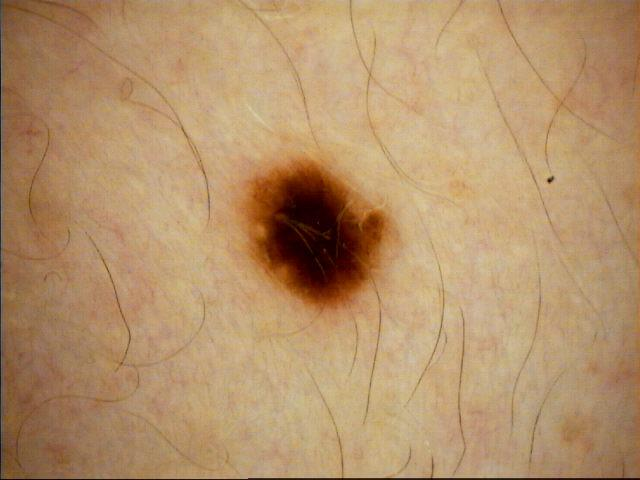

NameError: ignored

In [ ]:
#!pip install google.colab
from google.colab.patches import cv2_imshow
srcdir = '/content/gdrive/MyDrive/data/ISIC_2020_Test_JPEG/ISIC_2020_Test_Input'
count=0
for temp in os.listdir(srcdir):
    img = cv2.imread(os.path.join(srcdir, temp))
    cv2.imwrite(temp, img)
    cv2_imshow(img)
    img = cv2.resize(img, (28, 28))
    result = model.predict(img.reshape(1, 28, 28, 3))
    max_prob = max(result[0])
    class_ind = list(result[0]).index(max_prob)
    class_name = classes[class_ind]
    print(class_name)
    count+=1
    if count>10:
        break

Based on three different experiment, there are no changes on accuracy. 79% is the highest accuracy.